# Going Deeper_10. 도로 영역을 찾자! - 세그멘테이션 모델 만들기

## 1. 시맨틱 세그멘테이션 데이터셋

시맨틴 세그멘테이션(semantic segmentation) 으로 도로의 영역을 분리하기 위해서는 도로의 영역을 라벨로 가진 데이터셋을 가지고 학습할 수 있도록 파싱 해야 한다.저번에 했던 데이터 셋인 KITTI 데이터셋을 가지고 할 것이다.!!!! 

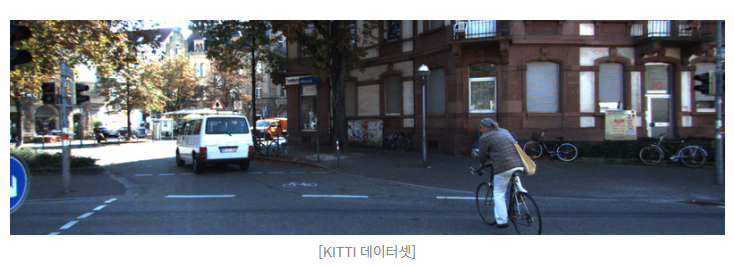

[KITTI 데이터셋]

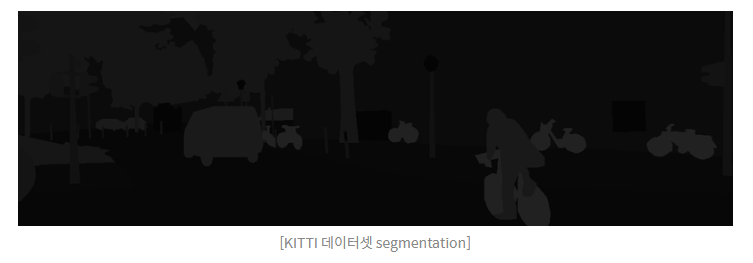

[KITTI 데이터셋 segmentaion]

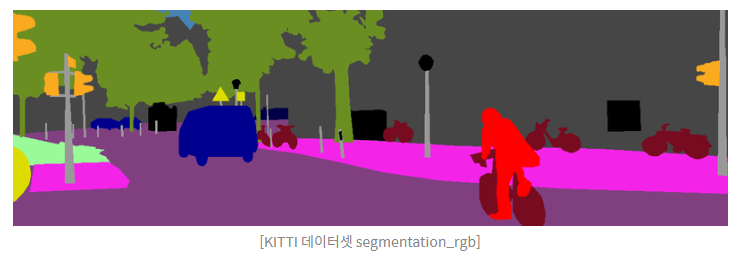

[KITTI 데이터셋 segmentation_rgb]

### (1) 이미지, 데이터 가져오기

<준비물>   
- mkdir -p ~/aiffel/semantic_segmentation/data  
- ln -s  ~/data/* ~/aiffel/semantic_segmentation/data/

### (2) 데이터 로더(data loader) 만들기

이제 이미지와 데이터셋이 주어졌으니 모델을 학습시킬 수 있는 데이터 로더(data loader)를 만들어봅시다. 
로더는 [입력값 (224, 224)], [출력값 (224, 244)] 크기를 갖는 모델을 학습시킬 수 있도록 데이터셋을 파싱 해야 한다.

In [1]:
##필요한 라이브러리를 로드 
import os
import math
import numpy as np
import pandas as pd
import tensorflow as tf

from PIL import Image
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from glob import glob

from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

Albumentation 의 사용법을 간단히 알아보자   
Albumentation에서 다양한 augmentation 기법을 확률적으로 적용할 수 있게 해주는 Compose()의 활용예

In [2]:
from albumentations import  HorizontalFlip, RandomSizedCrop, Compose, OneOf, Resize

def build_augmentation(is_train=True):
    if is_train:    ## 훈련용 데이터일 경우
        return Compose([
                        HorizontalFlip(p=0.5),    ## 50%의 확률로 좌우대칭
                        RandomSizedCrop(          ## 50%의 확률로 RandomSizedCrop
                            min_max_height=(300, 370),
                            w2h_ratio=370/1242,
                            height=224,
                            width=224,
                            p=0.5
                            ),
                        Resize(              ## 입력이미지를 224X224로 resize
                            width=224,
                            height=224
                            )
                        ])
    return Compose([      ## 테스트용 데이터일 경우에는 224X224로 resize만 수행
                Resize(
                    width=224,
                    height=224
                    )
                ])

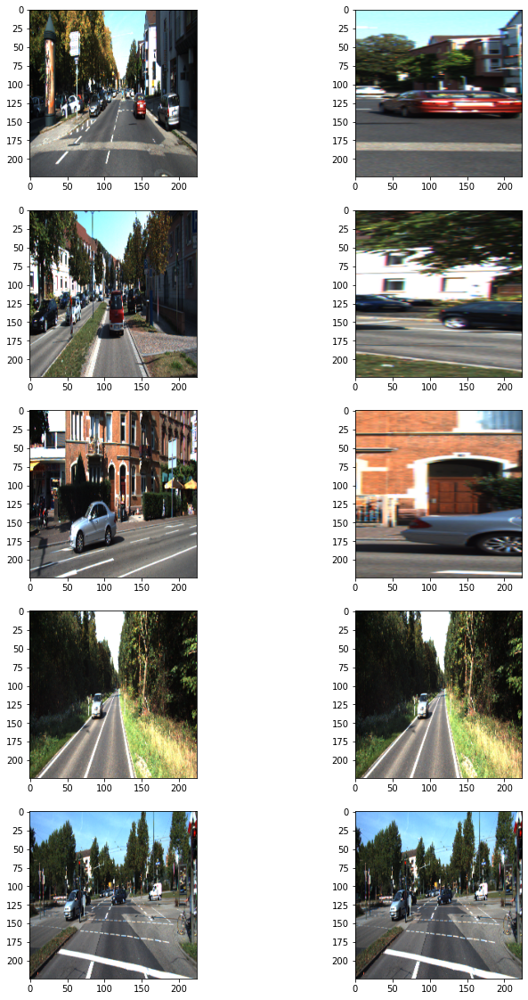

In [3]:
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

augmentation_train = build_augmentation()
augmentation_test = build_augmentation(is_train=False)
input_images = glob(os.path.join(dir_path, "image_2", "*.png"))

## 훈련 데이터셋에서 5개만 가져와 augmentation을 적용 
plt.figure(figsize=(12, 20))
for i in range(5):
    image = imread(input_images[i]) 
    image_data = {"image":image}
    resized = augmentation_test(**image_data)
    processed = augmentation_train(**image_data)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(resized["image"])  ## 왼쪽이 원본이미지
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(processed["image"])  ## 오른쪽이 augment된 이미지
  
plt.show()

이제 데이터셋을 구성해보자!!!

In [4]:
class KittiGenerator(tf.keras.utils.Sequence):
    '''
    KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
    우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
    '''
    def __init__(self, 
               dir_path,
               batch_size=4,
               img_size=(224, 224, 3),
               output_size=(224, 224),
               is_train=True,
               augmentation=None):
        '''
        dir_path: dataset의 directory path입니다.
        batch_size: batch_size입니다.
        img_size: preprocess에 사용할 입력이미지의 크기입니다.
        output_size: ground_truth를 만들어주기 위한 크기입니다.
        is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
        augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
        '''
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.is_train = is_train
        self.dir_path = dir_path
        self.augmentation = augmentation
        self.img_size = img_size
        self.output_size = output_size

        ## load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인
        self.data = self.load_dataset()

    def load_dataset(self):
        ## kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수이다.
        ## 이때 is_train에 따라 test set을 분리해서 load하도록 해야한다.
        input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
        label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
        input_images.sort()
        label_images.sort()
        assert len(input_images) == len(label_images)
        data = [ _ for _ in zip(input_images, label_images)]

        if self.is_train:
            return data[:-30]
        return data[-30:]
    
    def __len__(self):
        ## Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환함
        return math.ceil(len(self.data) / self.batch_size)

    def __getitem__(self, index):
        ## 입력과 출력을 만듭니다.
        ## 입력은 resize및 augmentation이 적용된 input image이고 
        ## 출력은 semantic label입니다.
        batch_data = self.data[
                               index*self.batch_size:
                               (index + 1)*self.batch_size
                               ]
        inputs = np.zeros([self.batch_size, *self.img_size])
        outputs = np.zeros([self.batch_size, *self.output_size])

        for i, data in enumerate(batch_data):
            input_img_path, output_path = data
            _input = imread(input_img_path)
            _output = imread(output_path)
            _output = (_output==7).astype(np.uint8)*1
            data = {
                "image": _input,
                "mask": _output,
                }
            augmented = self.augmentation(**data)
            inputs[i] = augmented["image"]/255
            outputs[i] = augmented["mask"]
            return inputs, outputs

    def on_epoch_end(self):
        ## 한 epoch가 끝나면 실행되는 함수 ->  학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있다.
        self.indexes = np.arange(len(self.data))
        if self.is_train == True :
            np.random.shuffle(self.indexes)
            return self.indexes

In [5]:
augmentation = build_augmentation()
test_preproc = build_augmentation(is_train=False)
        
train_generator = KittiGenerator(
    dir_path, 
    augmentation=augmentation,
)

test_generator = KittiGenerator(
    dir_path, 
    augmentation=test_preproc,
    is_train=False
)

## 2. 시맨틱 세그멘테이션 모델

### (1) 모델 구조 만들기

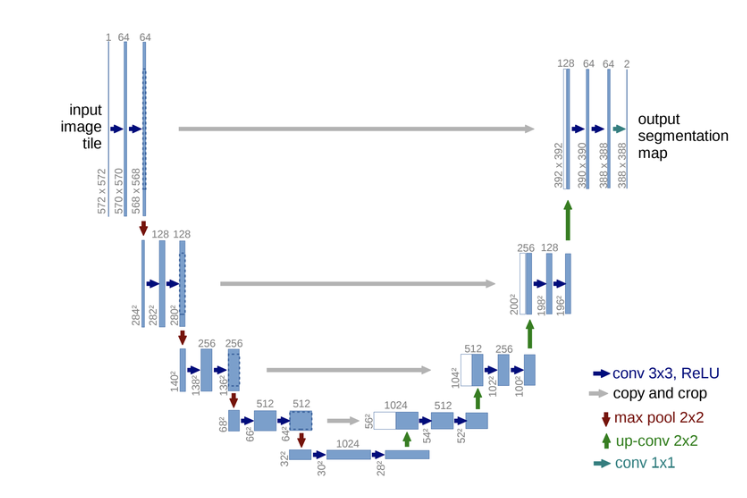

시맨틱 세그멘테이션을 위한 모델을 만들어주자!  
세그멘테이션 모델 중에서 구조상 비교적으로 구현이 단순한 U-Net 을 구현해보자!!

- 사용에 필요한 레이어와 연산
    - Conv2D, Conv2DTranspose, MaxPooling2D, concatenate

In [6]:
def build_unet(input_shape=(224, 224, 3)):
    ## input_shape에 따라 U-Net을 만들어주세요. 이때 model은 fully convolutional해야 한다.
    inputs = Input(input_shape)

    ## Contracting Path
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool4)  
    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv5)

    ## Expanding Path
    drop5 = Dropout(0.5)(conv5)
    up6 = Conv2D(512, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(drop5)) 
    merge6 = concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv6)
    up7 = Conv2D(256, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv6))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv7)
    up8 = Conv2D(128, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv8)
    up9 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)  
    conv9 = Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)     
    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs = inputs, outputs = conv10)
    return model

In [7]:
## 모델 구조

unet = build_unet()
unet.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 224, 224, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 224, 224, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 112, 112, 64) 0           conv2d_1[0][0]                   
______________________________________________________________________________________________

### (2) 모델 학습하기

위에서 모델을 만든걸로 위에서 만들어본 데이터셋과 학습을 해보자! 

In [8]:
unet.compile(optimizer = Adam(lr = 1e-4), loss = 'binary_crossentropy')
unet.fit_generator(
     generator=train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

/opt/conda/lib/python3.9/site-packages/keras/optimizer_v2/optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(
/opt/conda/lib/python3.9/site-packages/keras/engine/training.py:1972: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/100
43/43 [==============================] - 56s 248ms/step - loss: 0.4071 - val_loss: 0.1250
Epoch 2/100
43/43 [==============================] - 10s 235ms/step - loss: 0.1187 - val_loss: 0.1291
Epoch 3/100
43/43 [==============================] - 10s 238ms/step - loss: 0.0932 - val_loss: 0.0832
Epoch 4/100
43/43 [==============================] - 10s 238ms/step - loss: 0.1676 - val_loss: 0.0786
Epoch 5/100
43/43 [==============================] - 10s 239ms/step - loss: 0.1003 - val_loss: 0.0859
Epoch 6/100
43/43 [==============================] - 10s 238ms/step - loss: 0.0768 - val_loss: 0.0748
Epoch 7/100
43/43 [==============================] - 10s 239ms/step - loss: 0.0707 - val_loss: 0.0719
Epoch 8/100
43/43 [==============================] - 10s 240ms/step - loss: 0.0644 - val_loss: 0.0775
Epoch 9/100
43/43 [==============================] - 10s 242ms/step - loss: 0.0671 - val_loss: 0.0730
Epoch 10/100
43/43 [==============================] - 10s 243ms/step - loss: 0.071

In [9]:
unet_path = os.getenv('HOME')+'/aiffel/semanticsegmentation/seg_model_unet.h5'
unet.save(unet_path)  # 학습한 모델을 저장해 주세요.

# 프로젝트 : 개선된 U-Net 모델 만들기

## U-Net++ 구현

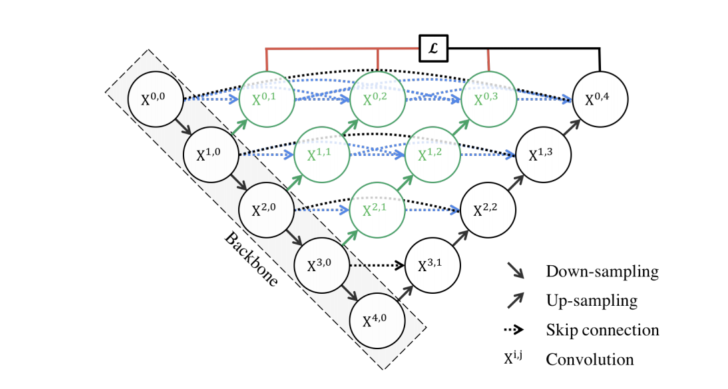

- U-Net++ 이란?   
    - U-Net++는 DenseNet의 Dense block 아이디어를 사용하여 U-Net을 향상시킨 모델입니다.  

- 기존 U-Net과 다른 점
    - skip pathways에 convolution 층이 있음. encoder와 decoder feature map 사이의 semantic gap을 연결해준다.
    - skip pathways에 dense skip이 있음. 기울기의 흐름을 향상 시킨다.
    - 모델 가지치기 그리고 향상이 가능하게 하거나 최악의 경우 loss 층만을 사용하는 것과 유사한 성능을 달성하는 deep supervision이 있음

### (1) 모델 구조 만들기

In [10]:
def build_unet_pp(input_shape=(224, 224, 3)):
    inputs = Input(input_shape)
    
    ## X0,0
    conv0_0 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    conv0_0 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv0_0)
    pool0_0 = MaxPooling2D(pool_size=(2, 2))(conv0_0)
    ## X1,0
    conv1_0 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool0_0)
    conv1_0 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1_0)
    pool1_0 = MaxPooling2D(pool_size=(2, 2))(conv1_0)
    ## X2,0
    conv2_0 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1_0)
    conv2_0 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2_0)
    pool2_0 = MaxPooling2D(pool_size=(2, 2))(conv2_0)
    ## X3,0
    conv3_0 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2_0)
    conv3_0 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3_0)
    pool3_0 = MaxPooling2D(pool_size=(2, 2))(conv3_0)
    ## X4,0
    conv4_0 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3_0)  
    conv4_0 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4_0)

    ## X0,1
    up1_0 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv1_0)) 
    merge0_1 = concatenate([up1_0, conv0_0], axis = 3)
    conv0_1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge0_1)
    conv0_1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv0_1)
    ## X1,1
    up2_0 = Conv2D(128, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv2_0))
    merge1_1 = concatenate([up2_0, conv1_0], axis = 3)
    conv1_1 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge1_1)
    conv1_1 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1_1)
    ## X2,1
    up3_0 = Conv2D(256, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv3_0))
    merge2_1 = concatenate([up3_0, conv2_0], axis = 3)
    conv2_1 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge2_1)
    conv2_1 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2_1)
    ## X3,1
    up4_0 = Conv2D(512, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv4_0))
    merge3_1 = concatenate([up4_0, conv3_0], axis = 3)
    conv3_1 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge3_1)
    conv3_1 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3_1)  
    
    ## X0,2
    up1_1 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv1_1)) 
    merge0_2 = concatenate([up1_1, conv0_0, conv0_1], axis = 3)
    conv0_2 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge0_2)
    conv0_2 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv0_2)
    ## X1,2
    up2_1 = Conv2D(128, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv2_1))
    merge1_2 = concatenate([up2_1, conv1_0, conv1_0], axis = 3)
    conv1_2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge1_2)
    conv1_2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1_2)
    ## X2,2
    up3_1 = Conv2D(256, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv3_1))
    merge2_2 = concatenate([up3_1, conv2_0, conv2_1], axis = 3)
    conv2_2 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge2_2)
    conv2_2 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2_2)

    ## X0,3
    up1_2 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv1_2)) 
    merge0_3 = concatenate([up1_2, conv0_0, conv0_1, conv0_2], axis = 3)
    conv0_3 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge0_3)
    conv0_3 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv0_3)
    ## X1,3
    up2_2 = Conv2D(128, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv2_2))
    merge1_3 = concatenate([up2_2, conv1_0, conv1_1, conv1_2], axis = 3)
    conv1_3 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge1_3)
    conv1_3 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1_3)
    
    ## X0,4
    up1_3 = Conv2D(64, 2, activation='relu', padding='same',kernel_initializer='he_normal')(UpSampling2D(size = (2,2))(conv1_3)) 
    merge0_4 = concatenate([up1_3, conv0_0, conv0_1, conv0_2, conv0_3], axis = 3)
    conv0_4 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge0_4)
    conv0_4 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv0_4)
    
    output = Conv2D(1, 1, activation='sigmoid')(conv0_4)
    model = Model(inputs = inputs, outputs = output)
    
    return model

In [11]:
## 모델 구조 확인하기

unet_pp = build_unet_pp()
unet_pp.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_24 (Conv2D)              (None, 224, 224, 64) 1792        input_2[0][0]                    
__________________________________________________________________________________________________
conv2d_25 (Conv2D)              (None, 224, 224, 64) 36928       conv2d_24[0][0]                  
__________________________________________________________________________________________________
max_pooling2d_4 (MaxPooling2D)  (None, 112, 112, 64) 0           conv2d_25[0][0]                  
____________________________________________________________________________________________

### (2) 모델 학습하기

In [12]:
unet_pp.compile(optimizer = Adam(lr = 1e-4), loss = 'binary_crossentropy')
unet_pp.fit_generator(
     generator=train_generator,
     validation_data=test_generator,
     steps_per_epoch=len(train_generator),
     epochs=100,
 )

Epoch 1/100
43/43 [==============================] - 34s 623ms/step - loss: 0.3686 - val_loss: 0.0977
Epoch 2/100
43/43 [==============================] - 26s 611ms/step - loss: 0.1069 - val_loss: 0.1641
Epoch 3/100
43/43 [==============================] - 26s 605ms/step - loss: 0.0785 - val_loss: 0.0814
Epoch 4/100
43/43 [==============================] - 26s 606ms/step - loss: 0.0734 - val_loss: 0.0609
Epoch 5/100
43/43 [==============================] - 26s 603ms/step - loss: 0.0583 - val_loss: 0.1246
Epoch 6/100
43/43 [==============================] - 26s 603ms/step - loss: 0.0620 - val_loss: 0.0569
Epoch 7/100
43/43 [==============================] - 26s 604ms/step - loss: 0.0787 - val_loss: 0.0660
Epoch 8/100
43/43 [==============================] - 26s 605ms/step - loss: 0.1178 - val_loss: 0.0666
Epoch 9/100
43/43 [==============================] - 26s 603ms/step - loss: 0.0718 - val_loss: 0.0683
Epoch 10/100
43/43 [==============================] - 26s 601ms/step - loss: 0.077

## U-Net과 U-Net++ 모델 수행 결과 분석  

두 모델의 정량적, 정성적 성능을 비교해 봅시다. 시각화, IoU 계산 등을 체계적으로 시도해 보면 차이를 발견하실 수 있을 것입니다.

In [13]:
unet_dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'
unet_path = unet_dir_path + '/seg_model_unet.h5'
unet = tf.keras.models.load_model(unet_path)

In [14]:
unet_pp_path = os.getenv('HOME')+'/aiffel/semanticsegmentation/seg_model_unet_pp.h5'
unet_pp.save(unet_pp_path)  ## 학습한 모델을 저장

In [15]:
unet = tf.keras.models.load_model(unet_path)
unet_pp = tf.keras.models.load_model(unet_pp_path)

In [16]:
def get_output(model, preproc, image_path, output_path):
    ## image_path로 입력된 이미지를 입력받아 preprocess를 해서 model로 infernece한 결과를 시각화하고 이를 output_path에 저장하는 함수
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>0.5).astype(np.uint8).squeeze(-1)*255  ## 0.5라는 threshold를 변경하면 도로인식 결과범위가 달라짐
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()
    return output

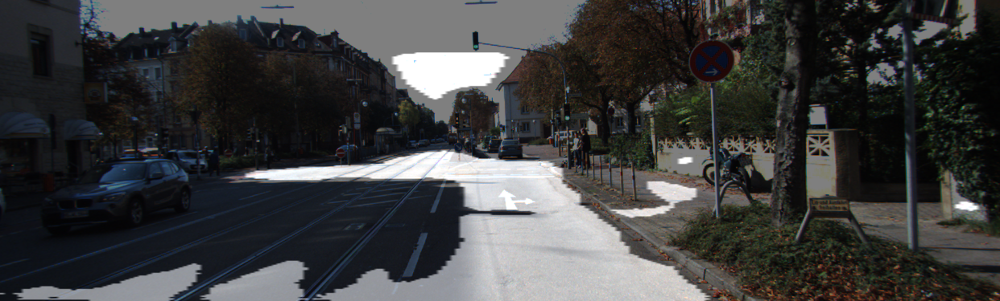

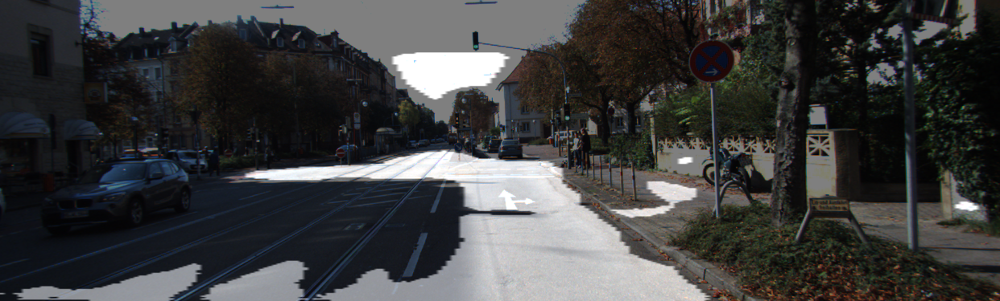

In [17]:
dir_path = os.getenv('HOME')+'/aiffel/semantic_segmentation/data/training'

## U-Net 추론 결과 시각화
i = 1    ## i값을 바꾸면 테스트용 파일이 달라짐
get_output(
     unet, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

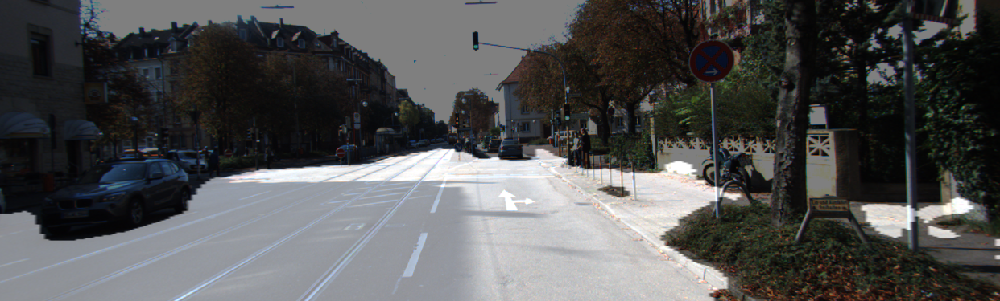

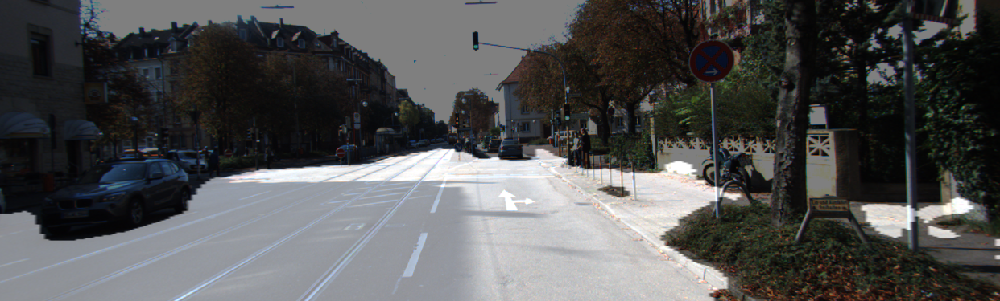

In [18]:
## U-Net++ 추론 결과 시각화
get_output(
     unet_pp, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

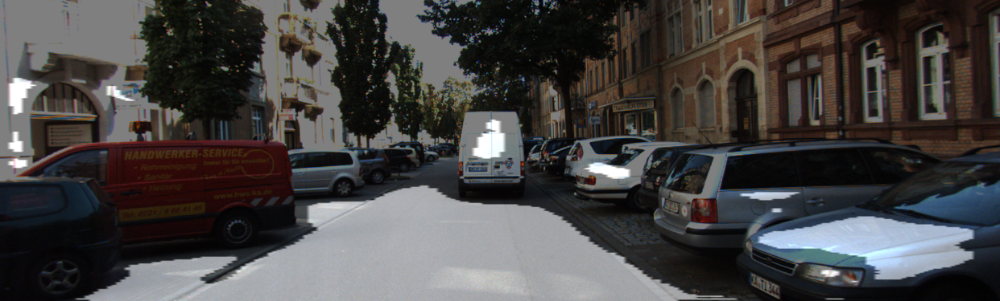

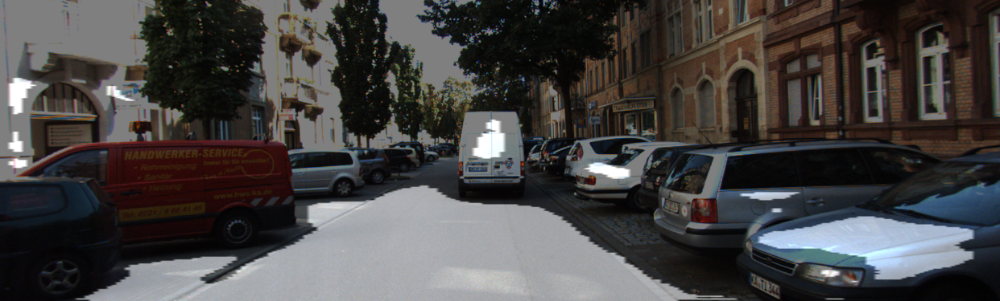

In [19]:
## U-Net 추론 결과 시각화
i = 5    ## i값을 바꾸면 테스트용 파일이 달라짐
get_output(
     unet, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )


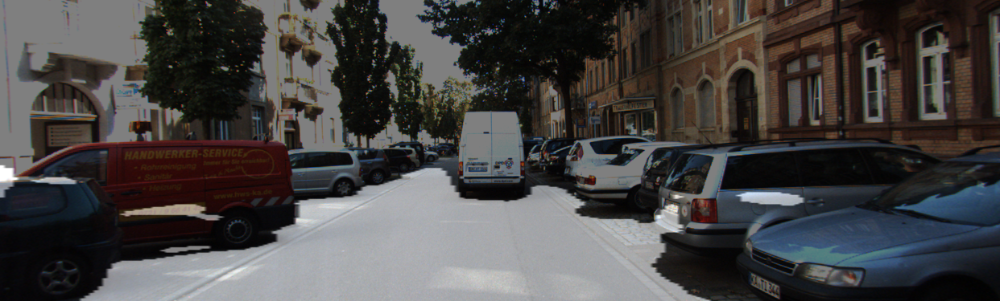

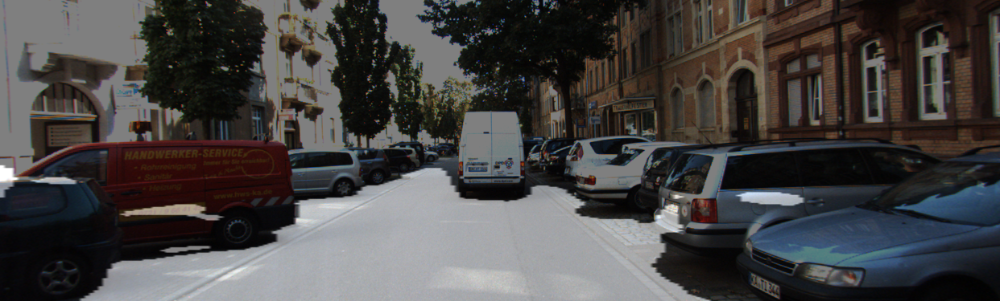

In [20]:
## U-Net++ 추론 결과 시각화
get_output(
     unet_pp, 
     test_preproc,
     image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
     output_path=dir_path + f'./result_{str(i).zfill(3)}.png'
 )

## IoU(Intersection over Union)  
- segmentation 성능을 정량적으로 측정하기 위한 방법이다.

In [21]:
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    print('IoU : %f' % iou_score )
    return iou_score

In [22]:
def get_output(model, preproc, image_path, output_path, label_path):
    origin_img = imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255  ## 0.5라는 threshold를 변경하면 도로인식 결과범위가 달라짐
    prediction = output/255   ## 도로로 판단한 영역
    
    output = Image.fromarray(output)
    background = Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = Image.blend(background, output, alpha=0.5)
    output.show()   ## 도로로 판단한 영역을 시각화!
     
    if label_path:   
        label_img = imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   ## 라벨에서 도로로 기재된 영역

        return output, prediction, target
    else:
        return output, prediction, _

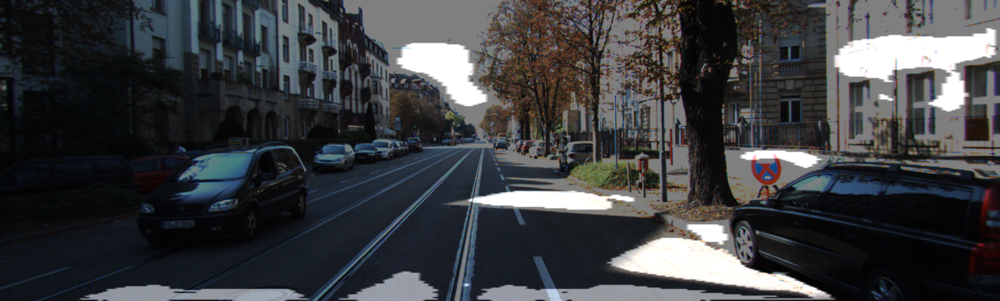

IoU : 0.169192


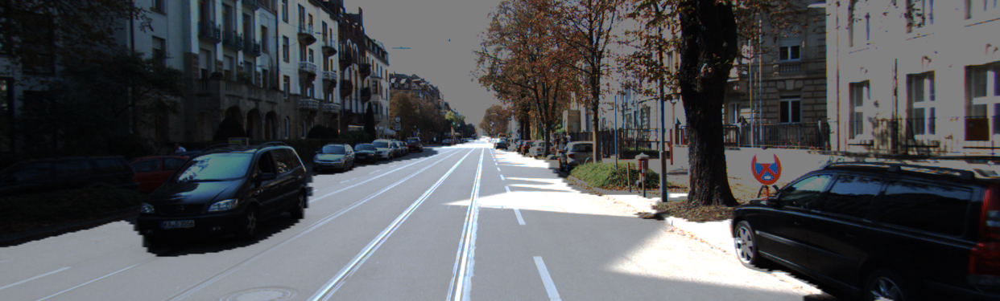

IoU : 0.913745


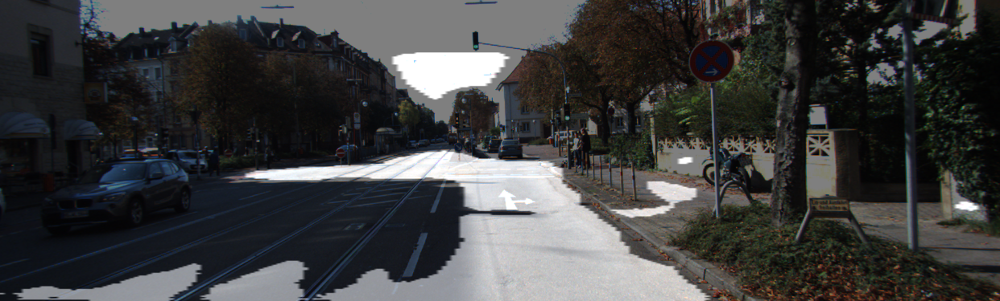

IoU : 0.419641


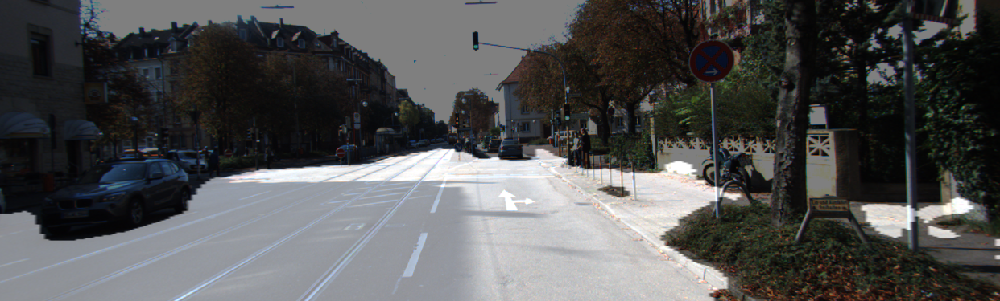

IoU : 0.847671


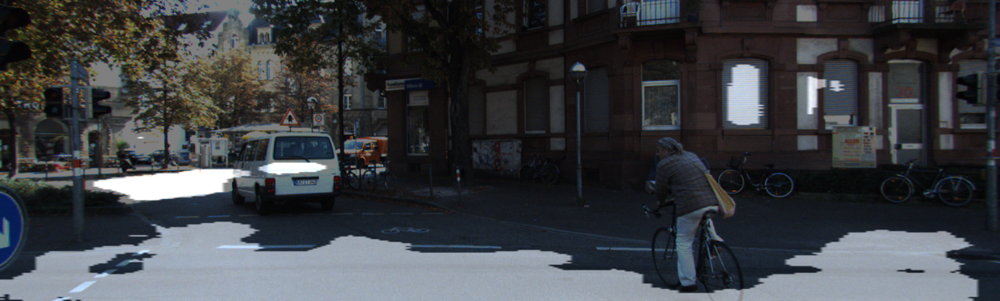

IoU : 0.584087


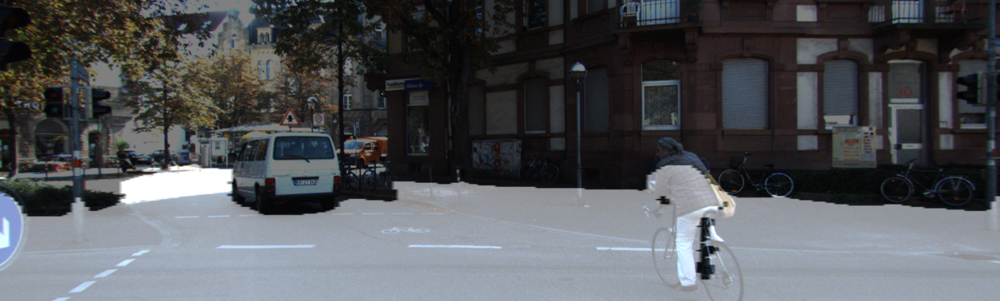

IoU : 0.617040


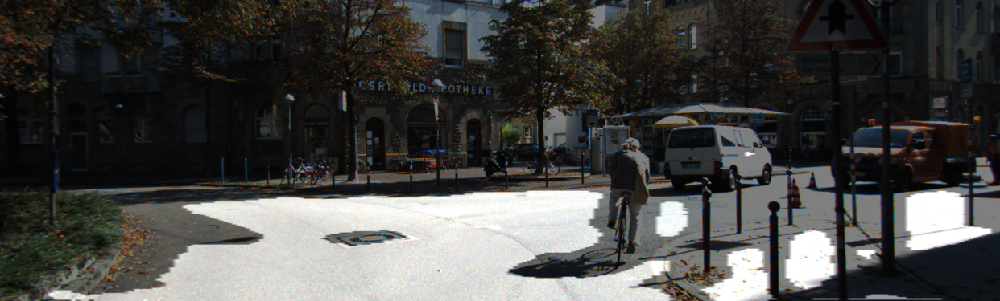

IoU : 0.571212


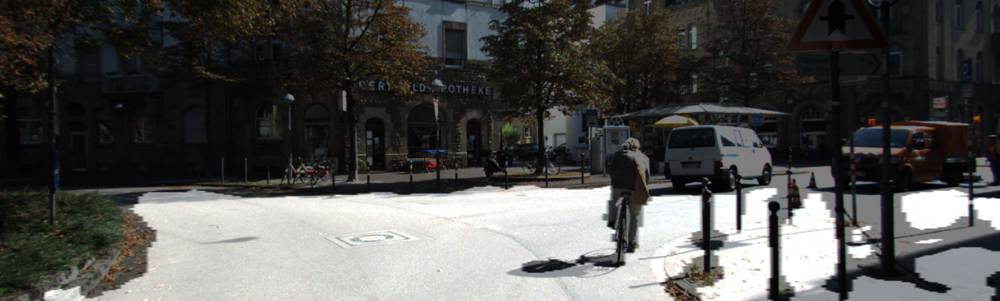

IoU : 0.663071


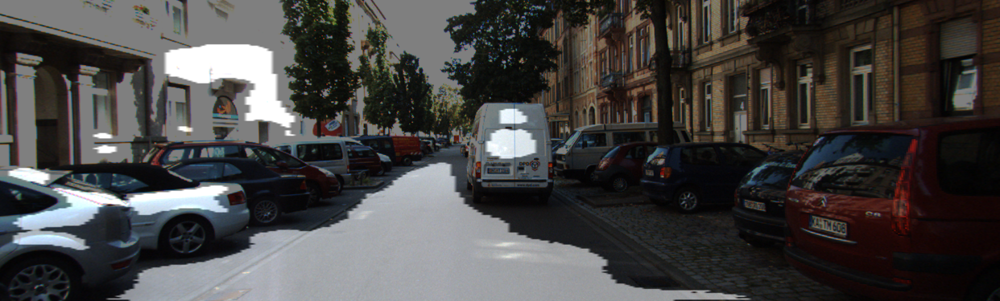

IoU : 0.560296


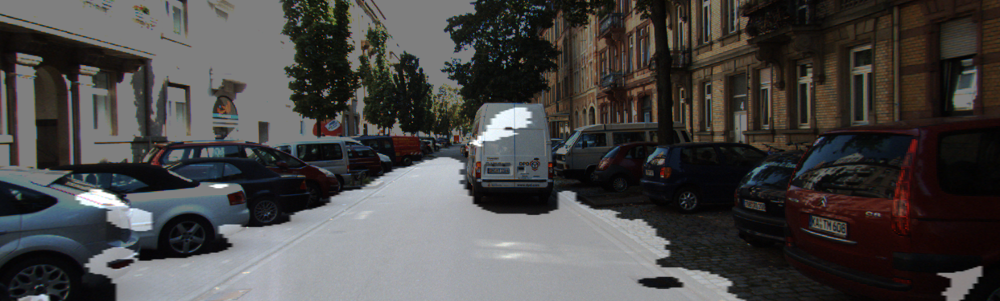

IoU : 0.655573


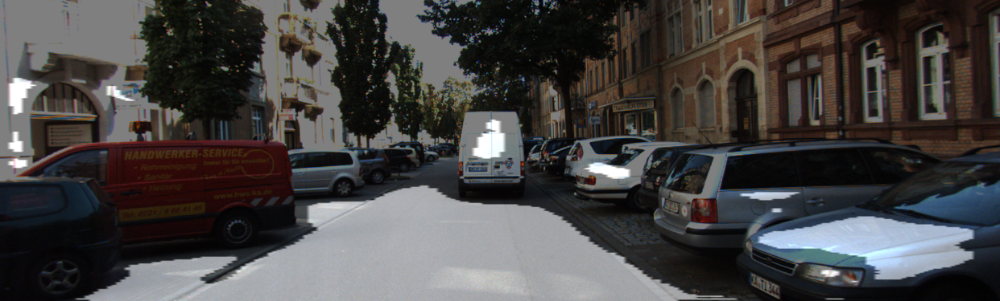

IoU : 0.647032


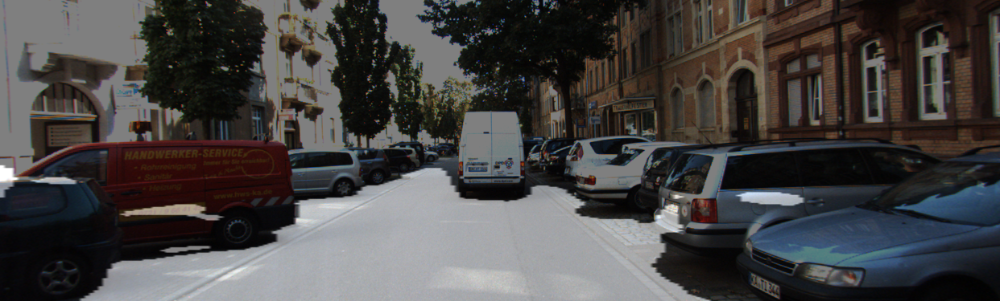

IoU : 0.692770


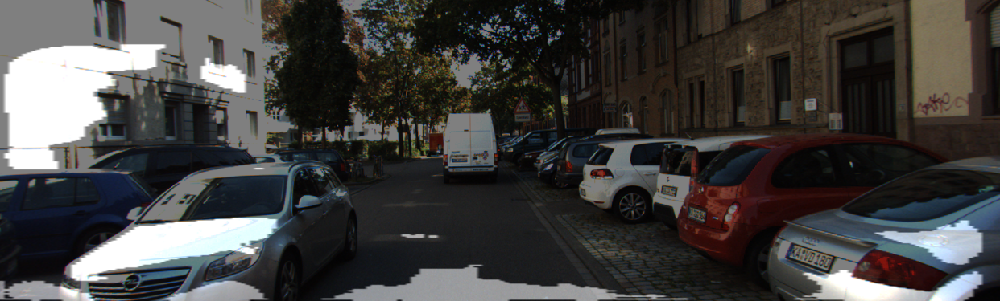

IoU : 0.096767


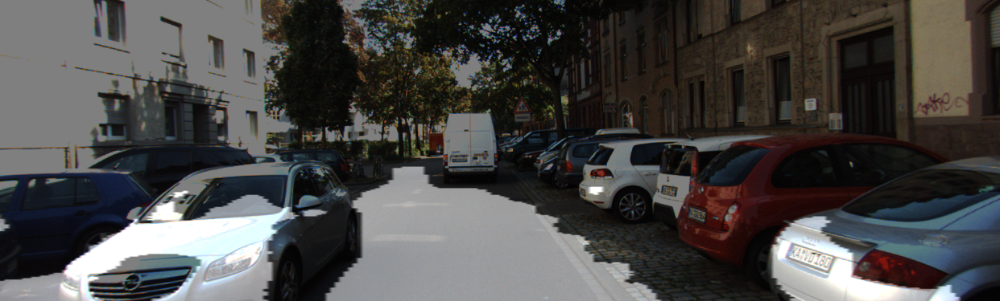

IoU : 0.468875


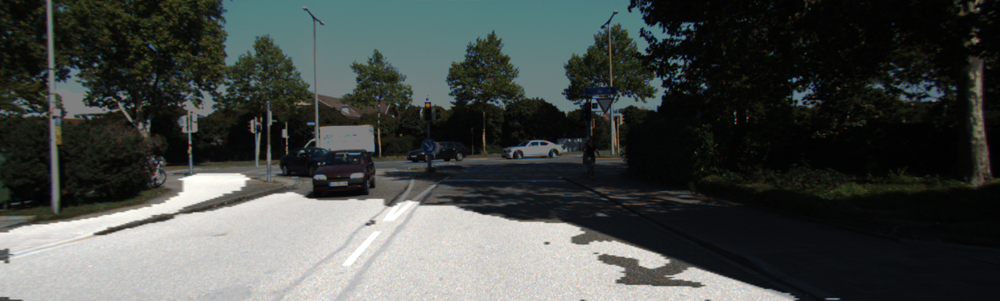

IoU : 0.682226


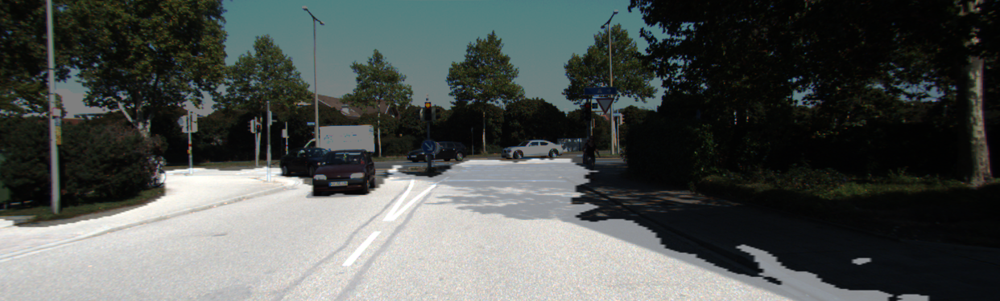

IoU : 0.826111


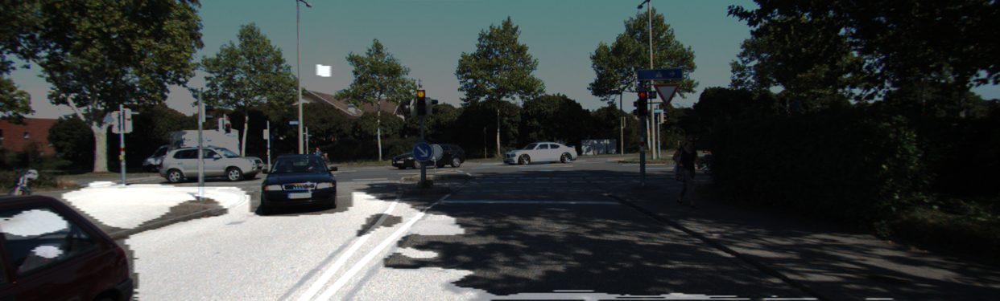

IoU : 0.382736


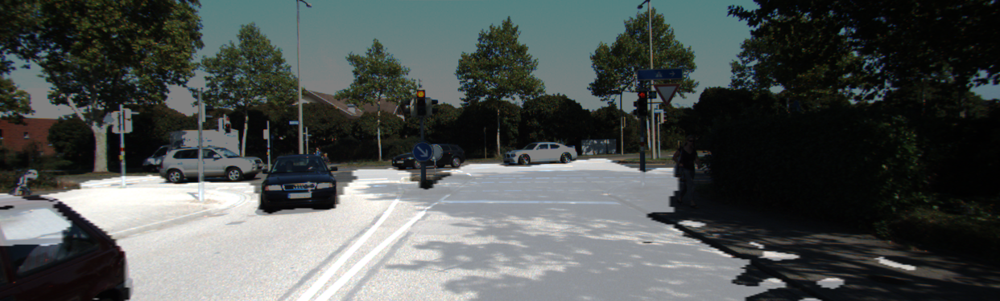

IoU : 0.797714


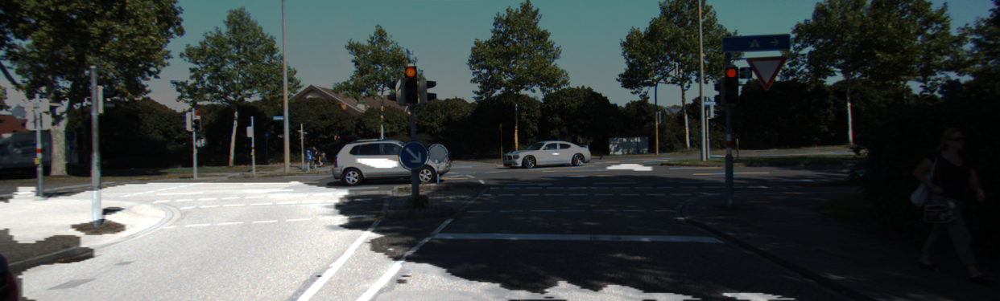

IoU : 0.417902


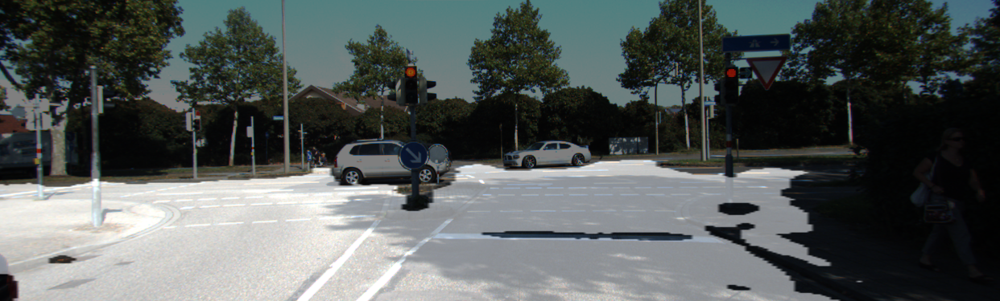

IoU : 0.775528


In [23]:
unet_iou = []
unet_pp_iou = []

for i in range(10):  ## 이미지 10개로 테스트
    ## U-Net의 IoU 계산
    output, prediction, target = get_output(
         unet, 
         test_preproc,
         image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
         output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
         label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )

    unet_iou.append(calculate_iou_score(target, prediction))

    ## U-Net++의 IoU 계산
    output, prediction, target = get_output(
         unet_pp, 
         test_preproc,
         image_path=dir_path + f'/image_2/00{str(i).zfill(4)}_10.png',
         output_path=dir_path + f'./result_{str(i).zfill(3)}.png',
         label_path=dir_path + f'/semantic/00{str(i).zfill(4)}_10.png'
     )

    unet_pp_iou.append(calculate_iou_score(target, prediction))

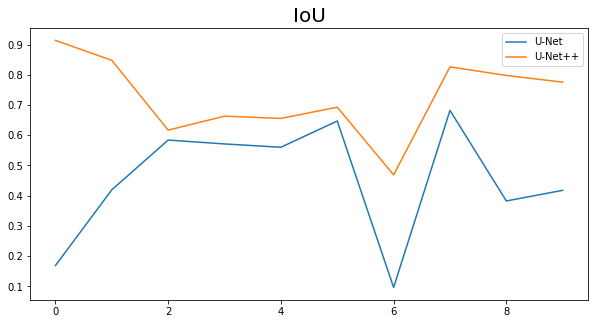

In [24]:
## 시각화

plt.figure(figsize=(10,5))
plt.plot(unet_iou)
plt.plot(unet_pp_iou)
plt.title('IoU', fontsize=20)
plt.legend(['U-Net', 'U-Net++'])
plt.show()

In [25]:
## IoU 평균 비교

df_iou = pd.DataFrame({'U-Net': unet_iou,
                       'U-Net++': unet_pp_iou})
df_iou.mean()

U-Net      0.453109
U-Net++    0.725810
dtype: float64

# 회고!!

## <어려운 점>  
U-Net 을 처음 공부했을 때 새로운 모델이라서 어려웠던 것 같다! Lecture 노드에 있는 것만으로는 부족해서 구글링을 많이해서 공부를 했던 것 같다 . 아직까지 이해를 다 못해서 다음에 복습을 하면서 더 익혀야 할 것 같다. 익스를 할 때는 세그멘테이션이 재밌다고 생각했는데 GD를 하니까 뭔가 모르게 배신감이 느껴진다고 해야하나..? 내용이 어려워서 그런지 뭔가 결과값이 눈으로 보여도 흥미도가 떨어지는 것 같다.....ㅜㅜ

## <알게된 점 & 아직 모호한 점>  
노드 11을 하면서 U-Net 을 알게 되었는데 프로젝트에는 U-Net++ 가 나와서 두 개가 정확히 뭔지는 모르겠지만 대충 어떤 느낌인지는 알겠다. 그리고 두 개가 뭔 차이가 있는지 찾아보고 알게되었다. 그리고 결과값을 보면 두 개가 차이가 많이 나는 것을 알 수 있다. U-Net 의 결과값을 시각화로 봤을 때는 오오오!! 이렇게 햇는데 IoU가 낮아서 쫌 실망스러웠다. U-Net++ 도 크게 다르지 않을 것이라고 생각했는데 위아래로 결과값을 비교해서 보니까 확연히 다른 것을 알 수 있었다. 그리고 IoU를 봤을 때도 평균적으로 30정도 차이가 나니까 확실히 우월한 것 같다. 


- U-Net++ 이란?   
    - U-Net++는 DenseNet의 Dense block 아이디어를 사용하여 U-Net을 향상시킨 모델입니다.  

- 기존 U-Net과 다른 점
    - skip pathways에 convolution 층이 있음. encoder와 decoder feature map 사이의 semantic gap을 연결해준다.
    - skip pathways에 dense skip이 있음. 기울기의 흐름을 향상 시킨다.
    - 모델 가지치기 그리고 향상이 가능하게 하거나 최악의 경우 loss 층만을 사용하는 것과 유사한 성능을 달성하는 deep supervision이 있음

## <자기다짐>  
아니 너무 점점 더 어려워지고 쉽지 않아서 힘들다.. 그래도 GD 는 편하게 개념만 알자고 다짐하니까 그나마 마음이 가볍다.. 그래도 아직 모델링하는 것은 너무 어렵고 혼자서 하기에는 벅찬 것 같다. 이번에도 U-Net에 대해서 한 가지 알았으니까 됐다!! 그리고 U-Net++ 도 알게되었고 결과값도 비교해봤으니까 괜찮다! 어려워지지만 할 수 있는 데까지 하고 부담 가지지 말자!! 화이팅~~